In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
!pwd

/content/drive/MyDrive


In [ ]:
!unzip archive.zip

unzip:  cannot find or open archive.zip, archive.zip.zip or archive.zip.ZIP.


In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from tensorflow.keras.preprocessing import image

In [ ]:
train_dataset = '/content/drive/MyDrive/DL_data/train'
test_dataset = '/content/drive/MyDrive/DL_data/test'
val_dataset = '/content/drive/MyDrive/DL_data/val'

In [10]:
train_datagen = image.ImageDataGenerator(
      rotation_range = 20,
      shear_range = 0.2,
      zoom_range = 0.2,
      horizontal_flip = True,
      width_shift_range = 0.1,
      height_shift_range = 0.1
  )
validation_datagen = image.ImageDataGenerator(
      rotation_range = 20,
      shear_range = 0.2,
      zoom_range = 0.2,
      horizontal_flip = True,
      width_shift_range = 0.1,
      height_shift_range = 0.1
  )
test_datagen = image.ImageDataGenerator(
      rotation_range = 20,
      shear_range = 0.2,
      zoom_range = 0.2,
      horizontal_flip = True,
      width_shift_range = 0.1,
      height_shift_range = 0.1
  )

In [11]:
train_generator = train_datagen.flow_from_directory(
    train_dataset,
    target_size = (256, 256),
    batch_size = 16,
    class_mode = 'categorical'
)

validation_generator = validation_datagen.flow_from_directory(
    val_dataset,
    target_size = (256, 256),
    batch_size = 16,
    shuffle = True,
    class_mode = 'categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_dataset,
    target_size = (256, 256),
    batch_size = 16,
    class_mode = 'categorical'
)

Found 3200 images belonging to 4 classes.
Found 2000 images belonging to 4 classes.
Found 800 images belonging to 4 classes.


In [12]:
train_generator.class_indices

{'0_normal': 0, '1_ulcerative_colitis': 1, '2_polyps': 2, '3_esophagitis': 3}

In [13]:
validation_generator.class_indices

{'0_normal': 0, '1_ulcerative_colitis': 1, '2_polyps': 2, '3_esophagitis': 3}

In [14]:
test_generator.class_indices

{'0_normal': 0, '1_ulcerative_colitis': 1, '2_polyps': 2, '3_esophagitis': 3}

In [15]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import GaussianNoise, GlobalAveragePooling2D, Dense, BatchNormalization, Dropout

base = EfficientNetB7(weights='imagenet', input_shape=(256, 256, 3), include_top=False)


258076736/258076736 [==============================] - 1s 0us/step


In [16]:
for layer in base.layers:
    layer.trainable = False

model = Sequential()

model.add(base)

model.add(GlobalAveragePooling2D())
model.add(BatchNormalization())
model.add(Dropout(0.3))
model.add(Dense(512, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.3))
model.add(Dense(4, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb7 (Functional  (None, 8, 8, 2560)        64097687  
 )                                                               
                                                                 
 global_average_pooling2d (  (None, 2560)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 batch_normalization (Batch  (None, 2560)              10240     
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 2560)              0         
                                                                 
 dense (Dense)               (None, 512)               1311232   
                                                        

In [17]:
model.compile(optimizer='adam',loss='categorical_crossentropy', metrics=['accuracy','Precision','Recall','AUC'])

In [18]:
history = model.fit(
    train_generator,
    steps_per_epoch=200,
    epochs = 10,
    validation_data = validation_generator
)

Epoch 1/10
200/200 [==============================] - 1466s 7s/step - loss: 0.3629 - accuracy: 0.8959 - precision: 0.9013 - recall: 0.8931 - auc: 0.9798 - val_loss: 0.3490 - val_accuracy: 0.8780 - val_precision: 0.8991 - val_recall: 0.8600 - val_auc: 0.9782
Epoch 2/10
200/200 [==============================] - 151s 757ms/step - loss: 0.1648 - accuracy: 0.9409 - precision: 0.9417 - recall: 0.9391 - auc: 0.9938 - val_loss: 0.2604 - val_accuracy: 0.9115 - val_precision: 0.9183 - val_recall: 0.9050 - val_auc: 0.9877
Epoch 3/10
200/200 [==============================] - 151s 754ms/step - loss: 0.1637 - accuracy: 0.9463 - precision: 0.9480 - recall: 0.9453 - auc: 0.9936 - val_loss: 0.2511 - val_accuracy: 0.9085 - val_precision: 0.9178 - val_recall: 0.9040 - val_auc: 0.9888
Epoch 4/10
200/200 [==============================] - 153s 766ms/step - loss: 0.1350 - accuracy: 0.9519 - precision: 0.9539 - recall: 0.9506 - auc: 0.9961 - val_loss: 0.2289 - val_accuracy: 0.9140 - val_precision: 0.9189 -

In [19]:
model.evaluate(train_generator)

200/200 [==============================] - 92s 458ms/step - loss: 0.0247 - accuracy: 0.9903 - precision: 0.9909 - recall: 0.9903 - auc: 0.9997


[0.02467648684978485,
 0.9903125166893005,
 0.9909318089485168,
 0.9903125166893005,
 0.9996938109397888]

In [20]:
model.evaluate(validation_generator)

125/125 [==============================] - 58s 461ms/step - loss: 0.1564 - accuracy: 0.9425 - precision: 0.9453 - recall: 0.9420 - auc: 0.9946


[0.15639156103134155,
 0.9424999952316284,
 0.9453085660934448,
 0.9419999718666077,
 0.9945528507232666]

In [21]:
model.evaluate(test_generator)

50/50 [==============================] - 203s 4s/step - loss: 0.1636 - accuracy: 0.9413 - precision: 0.9434 - recall: 0.9375 - auc: 0.9939


[0.16355015337467194,
 0.9412500262260437,
 0.9433962106704712,
 0.9375,
 0.9938578605651855]

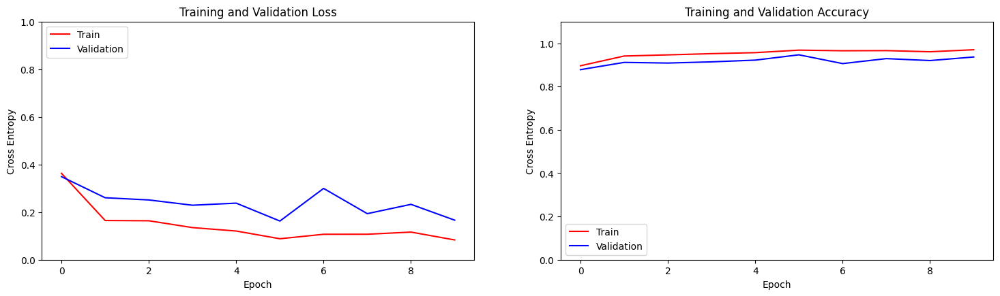

In [44]:
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']

accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

plt.figure(figsize=(18, 10))
plt.subplot(2,2,1)
plt.plot(loss, 'r')
plt.plot(val_loss, 'b')
plt.ylabel('Cross Entropy')
plt.xlabel('Epoch')
plt.ylim(0,1)
plt.title('Training and Validation Loss')
plt.legend(['Train', 'Validation'], loc='upper left')


plt.subplot(2,2,2)
plt.plot(accuracy, 'r')
plt.plot(val_accuracy, 'b')
plt.ylabel('Cross Entropy')
plt.xlabel('Epoch')
plt.ylim(0,1.1)
plt.title('Training and Validation Accuracy')
plt.legend(['Train', 'Validation'], loc='lower left')

plt.show()

50/50 [==============================] - 29s 451ms/step


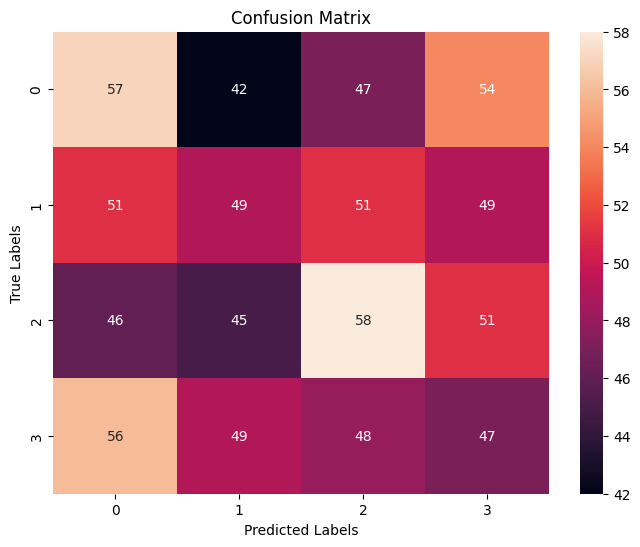

In [45]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

y_pred = model.predict(test_generator)
y_pred = np.argmax(y_pred, axis=1)

y_test = test_generator.classes

cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

1/1 [==============================] - 9s 9s/step
[[1.7610806e-03 5.2405428e-04 9.9770063e-01 1.4320535e-05]]
This image seems to be: Polyp


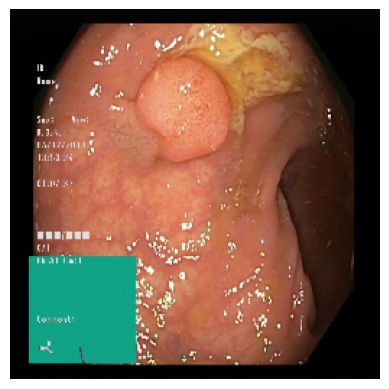

In [46]:
from tensorflow.keras.preprocessing import image
img = image.load_img('/content/drive/MyDrive/DL_data/test/2_polyps/test_polyps_ (1).jpg', target_size=(256, 256))
imag = image.img_to_array(img)
imaga = np.expand_dims(imag,axis=0)
ypred = model.predict(imaga)
print(ypred)
a=np.argmax(ypred,-1)


if (a == 0).any():
    op = "Normal"
elif (a == 1).any():
    op = "Ulcerative colitis"
elif (a == 2).any():
    op = "Polyp"
else:
    op = "Esophagitis"
plt.axis('off')

plt.imshow(img)
print("This image seems to be: "+str(op))

1/1 [==============================] - 0s 46ms/step


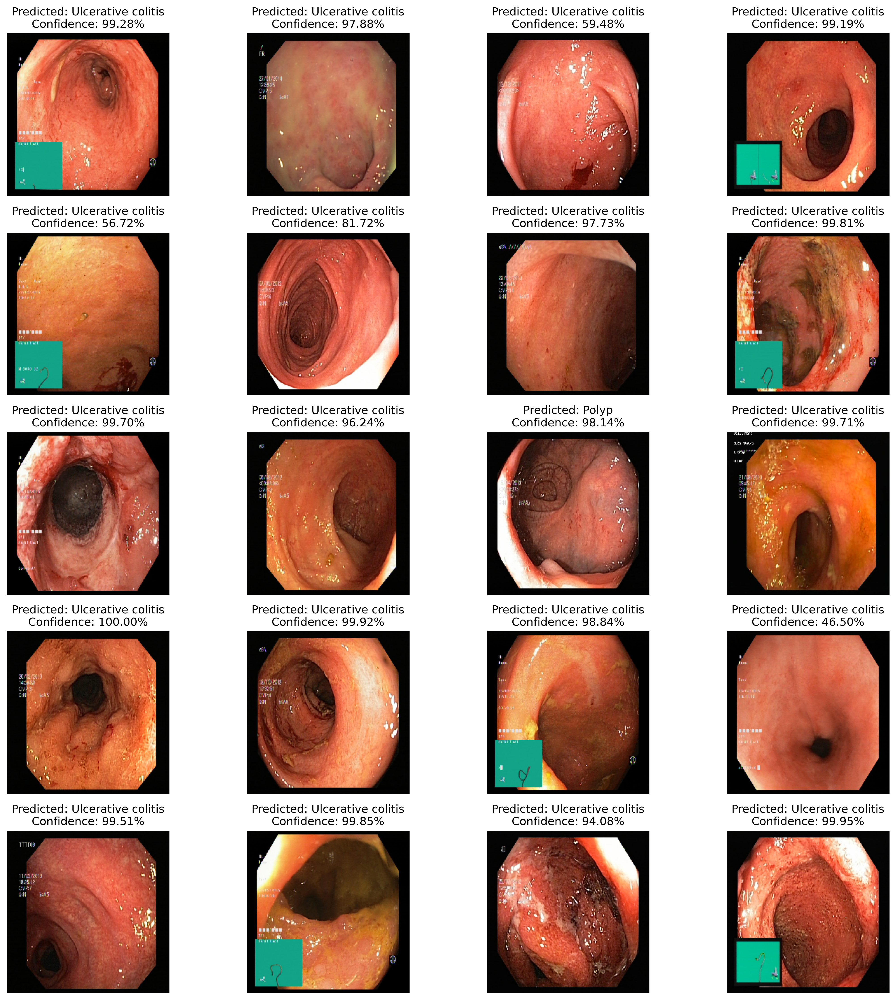

In [75]:
import os

test_dir = '/content/drive/MyDrive/DL_data/test/1_ulcerative_colitis'

num_rows = 5
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15), dpi=300)
image_files = os.listdir(test_dir)

for i, filename in enumerate(image_files):
    if i >= num_rows * num_cols:
        break  # Stop the loop if we have displayed enough images

    img_path = os.path.join(test_dir, filename)
    img = image.load_img(img_path, target_size=(256, 256))
    imag = image.img_to_array(img)
    imaga = np.expand_dims(imag, axis=0)

    ypred = model.predict(imaga)
    a = np.argmax(ypred, -1)
    confidence = ypred[0][a[0]] * 100

    if a[0] == 0:
        op = "Normal"
    elif a[0] == 1:
        op = "Ulcerative colitis"
    elif a[0] == 2:
        op = "Polyp"
    else:
        op = "Esophagitis"

    row = i // num_cols
    col = i % num_cols

    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    axes[row, col].set_title("Predicted: " + op + "\nConfidence: {:.2f}%".format(confidence))

for j in range(i + 1, num_rows * num_cols):
    row = j // num_cols
    col = j % num_cols
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()

1/1 [==============================] - 0s 44ms/step


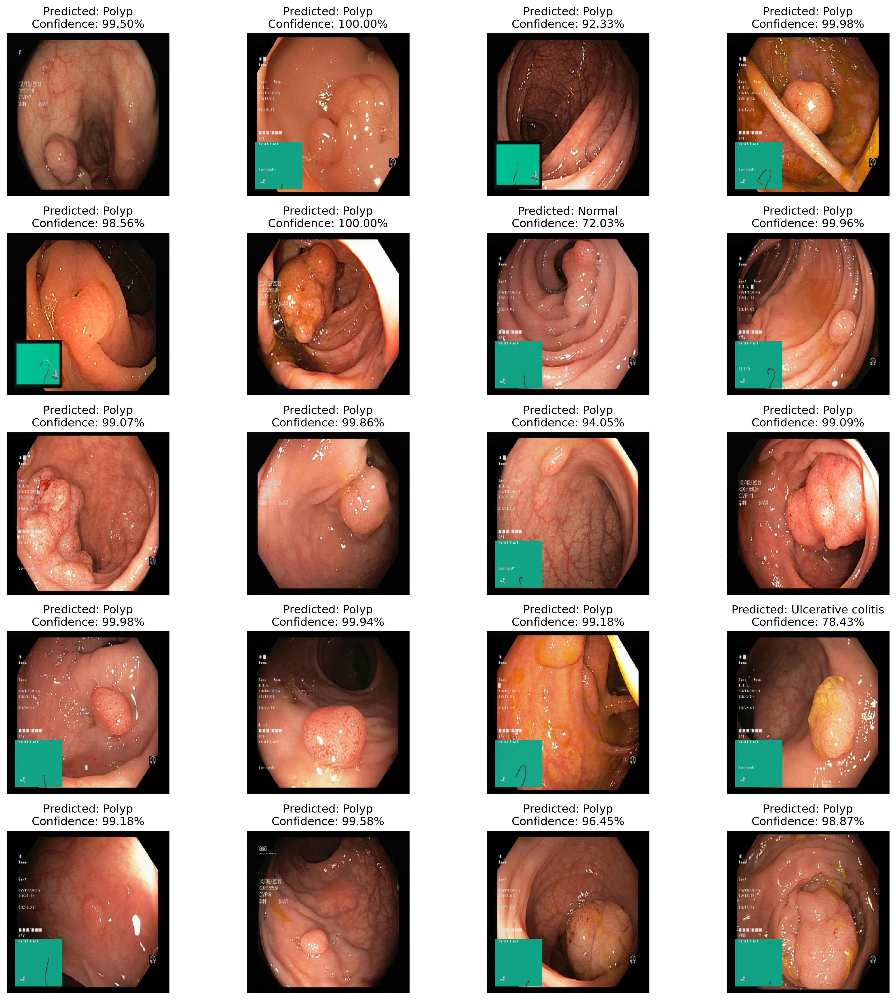

In [76]:
import os

test_dir = '/content/drive/MyDrive/DL_data/test/2_polyps'

num_rows = 5
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15), dpi=300)
image_files = os.listdir(test_dir)

for i, filename in enumerate(image_files):
    if i >= num_rows * num_cols:
        break  # Stop the loop if we have displayed enough images

    img_path = os.path.join(test_dir, filename)
    img = image.load_img(img_path, target_size=(256, 256))
    imag = image.img_to_array(img)
    imaga = np.expand_dims(imag, axis=0)

    ypred = model.predict(imaga)
    a = np.argmax(ypred, -1)
    confidence = ypred[0][a[0]] * 100

    if a[0] == 0:
        op = "Normal"
    elif a[0] == 1:
        op = "Ulcerative colitis"
    elif a[0] == 2:
        op = "Polyp"
    else:
        op = "Esophagitis"

    row = i // num_cols
    col = i % num_cols

    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    axes[row, col].set_title("Predicted: " + op + "\nConfidence: {:.2f}%".format(confidence))

for j in range(i + 1, num_rows * num_cols):
    row = j // num_cols
    col = j % num_cols
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()